# Thermal Infrared Object Detection For Aerial Crafts


# Required Libraries

In [21]:
from PIL import Image
from pathlib import Path
import yaml
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
from tqdm.auto import tqdm
import os
import requests
import zipfile
import cv2
import math
import glob
import random
import torch.nn as nn

# Data Collection and Preparation

In [22]:
def read_txt(txt_url: str):
    result = pd.read_csv(txt_url, sep=' ', names=['label', 'x_center', 'y_center', 'width', 'height']).values
    return result

def read_annotations(img_url: str):
    img_url = Path(img_url)
    stem = img_url.stem
    split = img_url.parent.name
    dataset_url = img_url.parent.parent.parent
    txt_name = f"{stem}.txt"
    txt_url = dataset_url / 'labels' / split / txt_name
    if txt_url.exists():
        return read_txt(str(txt_url))
    else:
        return None

def read_yolo_dataset(
    yaml_path: str,
    data_dir: str,
):
    data_dir = Path(data_dir)

    yaml_dict = yaml.safe_load(Path(yaml_path).read_text())
    images_list = [str(p) for p in data_dir.rglob('images/*/*.jpg')]

    df = pd.DataFrame(columns=['url'], data=images_list)

    df['size'] = df['url'].apply(lambda x: Image.open(x).size)
    df['img_abs_width'] = df['size'].apply(lambda x: x[0])
    df['img_abs_height'] = df['size'].apply(lambda x: x[1])
    df['annotations'] = df['url'].apply(lambda x: read_annotations(x))
    
    df = df[~df['annotations'].isna()]
    df = df.explode('annotations')
    df = df.reset_index(drop=True)

    df['class_id'] = df['annotations'].apply(lambda x: x[0])
    df['x_center_rel'] = df['annotations'].apply(lambda x: x[1])
    df['y_center_rel'] = df['annotations'].apply(lambda x: x[2])
    df['width_rel'] = df['annotations'].apply(lambda x: x[3])
    df['height_rel'] = df['annotations'].apply(lambda x: x[4])
    df['class_str'] = df['class_id'].apply(lambda x: yaml_dict['names'][int(x)].lower())
    df['x_center_abs'] = df.apply(lambda x: x['x_center_rel'] * x['size'][0], axis=1)
    df['y_center_abs'] = df.apply(lambda x: x['y_center_rel'] * x['size'][1], axis=1)
    df['width_abs'] = df.apply(lambda x: x['width_rel'] * x['size'][0], axis=1)
    df['height_abs'] = df.apply(lambda x: x['height_rel'] * x['size'][1], axis=1)
    df['aspect_ratio'] = df.apply(lambda x: x['width_rel'] / x['height_rel'], axis=1)
    df['split'] = df.apply(lambda x: Path(x['url']).parent.name, axis=1)
    return df

In [23]:
yaml_path = "hit-uav/dataset.yaml"
data_path = "hit-uav/"

In [24]:
df=read_yolo_dataset(yaml_path,data_path)

In [25]:
df

,url,size,img_abs_width,img_abs_height,annotations,class_id,x_center_rel,y_center_rel,width_rel,height_rel,class_str,x_center_abs,y_center_abs,width_abs,height_abs,aspect_ratio,split
0,hit-uav\images\test\0_100_30_0_03307.jpg,"(640, 512)",640,512,"[1.0, 0.3171875, 0.2451171875, 0.053125, 0.068...",1.0,0.317188,0.245117,0.053125,0.068359,car,203.0,125.5,34.0,35.0,0.777143,test
1,hit-uav\images\test\0_100_30_0_03307.jpg,"(640, 512)",640,512,"[1.0, 0.56015625, 0.201171875, 0.0578125, 0.07...",1.0,0.560156,0.201172,0.057813,0.074219,car,358.5,103.0,37.0,38.0,0.778947,test
2,hit-uav\images\test\0_100_30_0_03307.jpg,"(640, 512)",640,512,"[1.0, 0.1890625, 0.2880859375, 0.046875, 0.052...",1.0,0.189062,0.288086,0.046875,0.052734,car,121.0,147.5,30.0,27.0,0.888889,test
3,hit-uav\images\test\0_100_30_0_03307.jpg,"(640, 512)",640,512,"[1.0, 0.5421875, 0.08203125, 0.03125, 0.04296875]",1.0,0.542188,0.082031,0.031250,0.042969,car,347.0,42.0,20.0,22.0,0.727273,test
4,hit-uav\images\test\0_100_30_0_03307.jpg,"(640, 512)",640,512,"[1.0, 0.65546875, 0.1796875, 0.0453125, 0.0546...",1.0,0.655469,0.179688,0.045312,0.054688,car,419.5,92.0,29.0,28.0,0.828571,test
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24894,hit-uav\images\val\1_90_90_0_01590.jpg,"(640, 512)",640,512,"[0.0, 0.64921875, 0.517578125, 0.0203125, 0.02...",0.0,0.649219,0.517578,0.020313,0.027344,person,415.5,265.0,13.0,14.0,0.742857,val
24895,hit-uav\images\val\1_90_90_0_01590.jpg,"(640, 512)",640,512,"[0.0, 0.53671875, 0.515625, 0.0234375, 0.02734...",0.0,0.536719,0.515625,0.023438,0.027344,person,343.5,264.0,15.0,14.0,0.857143,val
24896,hit-uav\images\val\1_90_90_0_05060.jpg,"(640, 512)",640,512,"[1.0, 0.82578125, 0.302734375, 0.1109375, 0.22...",1.0,0.825781,0.302734,0.110937,0.226562,car,528.5,155.0,71.0,116.0,0.489655,val
24897,hit-uav\images\val\1_90_90_0_05060.jpg,"(640, 512)",640,512,"[2.0, 0.02578125, 0.9130859375, 0.0515625, 0.0...",2.0,0.025781,0.913086,0.051562,0.037109,bicycle,16.5,467.5,33.0,19.0,1.389474,val


In [26]:
df.head()

,url,size,img_abs_width,img_abs_height,annotations,class_id,x_center_rel,y_center_rel,width_rel,height_rel,class_str,x_center_abs,y_center_abs,width_abs,height_abs,aspect_ratio,split
0,hit-uav\images\test\0_100_30_0_03307.jpg,"(640, 512)",640,512,"[1.0, 0.3171875, 0.2451171875, 0.053125, 0.068...",1.0,0.317188,0.245117,0.053125,0.068359,car,203.0,125.5,34.0,35.0,0.777143,test
1,hit-uav\images\test\0_100_30_0_03307.jpg,"(640, 512)",640,512,"[1.0, 0.56015625, 0.201171875, 0.0578125, 0.07...",1.0,0.560156,0.201172,0.057813,0.074219,car,358.5,103.0,37.0,38.0,0.778947,test
2,hit-uav\images\test\0_100_30_0_03307.jpg,"(640, 512)",640,512,"[1.0, 0.1890625, 0.2880859375, 0.046875, 0.052...",1.0,0.189062,0.288086,0.046875,0.052734,car,121.0,147.5,30.0,27.0,0.888889,test
3,hit-uav\images\test\0_100_30_0_03307.jpg,"(640, 512)",640,512,"[1.0, 0.5421875, 0.08203125, 0.03125, 0.04296875]",1.0,0.542188,0.082031,0.031250,0.042969,car,347.0,42.0,20.0,22.0,0.727273,test
4,hit-uav\images\test\0_100_30_0_03307.jpg,"(640, 512)",640,512,"[1.0, 0.65546875, 0.1796875, 0.0453125, 0.0546...",1.0,0.655469,0.179688,0.045312,0.054688,car,419.5,92.0,29.0,28.0,0.828571,test


In [27]:
df.describe()

,img_abs_width,img_abs_height,class_id,x_center_rel,y_center_rel,width_rel,height_rel,x_center_abs,y_center_abs,width_abs,height_abs,aspect_ratio
count,24899.0,24899.0,24899.000000,24899.000000,24899.000000,24899.000000,24899.000000,24899.000000,24899.000000,24899.000000,24899.000000,24899.000000
mean,640.0,512.0,0.735250,0.506489,0.451331,0.044899,0.062266,324.152817,231.081449,28.735451,31.880316,0.732736
std,0.0,0.0,0.837672,0.253180,0.262989,0.037747,0.043709,162.035053,134.650350,24.158045,22.379091,0.413960
min,640.0,512.0,0.000000,0.002344,0.003906,0.004687,0.007812,1.500000,2.000000,3.000000,4.000000,0.115789
25%,640.0,512.0,0.000000,0.314063,0.232422,0.017188,0.035156,201.000000,119.000000,11.000000,18.000000,0.444444
50%,640.0,512.0,1.000000,0.505469,0.439453,0.029687,0.046875,323.500000,225.000000,19.000000,24.000000,0.610909
75%,640.0,512.0,1.000000,0.703125,0.655273,0.059375,0.070312,450.000000,335.500000,38.000000,36.000000,0.880000
max,640.0,512.0,4.000000,0.996875,0.996094,0.473438,0.361328,638.000000,510.000000,303.000000,185.000000,4.888889


In [28]:
pd.DataFrame(data={
    'images': df.groupby('split')['url'].unique().apply(len).to_dict(),
    'instances': df['split'].value_counts().to_dict(),
})

,images,instances
test,571,4811
train,2008,17628
val,287,2460


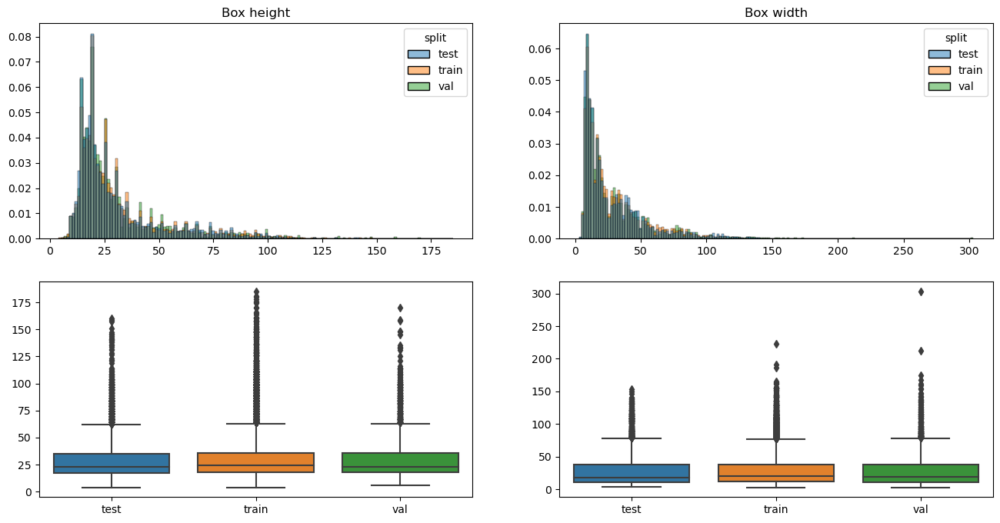

In [29]:
fig, axs = plt.subplots(2, 2, figsize=(16, 8))
sns.histplot(x='height_abs', hue='split', data=df, stat="density", common_norm=False, ax=axs[0][0])
sns.histplot(x='width_abs', hue='split', data=df, stat="density", common_norm=False, ax=axs[0][1])
sns.boxplot(y='height_abs', x='split', data=df, ax=axs[1][0])
sns.boxplot(y='width_abs', x='split', data=df, ax=axs[1][1])
axs[0][0].set_title('Box height')
axs[0][1].set_title('Box width')
for ax in axs.ravel():
    ax.set_xlabel('')
    ax.set_ylabel('')
plt.show()

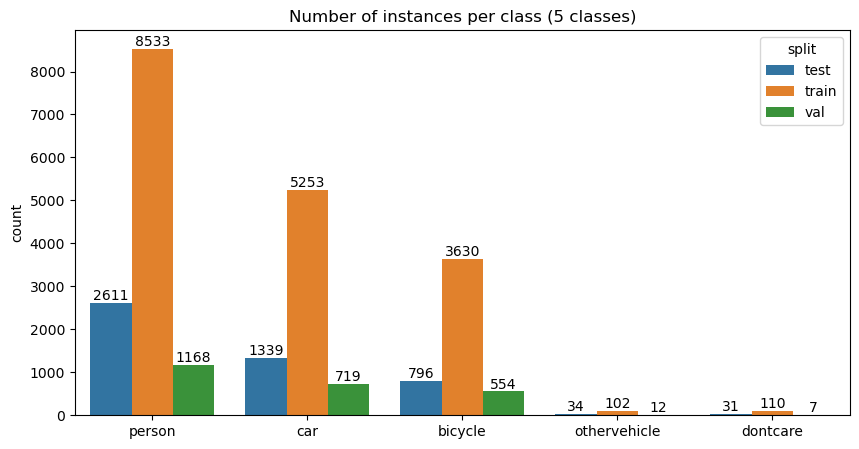

In [30]:
fig, ax = plt.subplots(figsize=(10, 5))
order = df['class_str'].value_counts().sort_values(ascending=False).index
sns.countplot(x='class_str', hue='split', data=df, ax=ax, order=order)
plt.xlabel('')
for i in ax.containers:
    ax.bar_label(i)
plt.title(f"Number of instances per class ({len(df.class_str.value_counts())} classes)")
plt.show()

# Model Selection

In [31]:
ROOT_DIR = "hit-uav/"
train_imgs_dir = "images/train"
train_labels_dir = "labels/train"
val_imgs_dir = "images/val"
val_labels_dir = "labels/val"
test_imgs_dir = "images/test"
test_labels_dir = "labels/test"
classes = ['Person', 'Car', 'Bicycle', 'OtherVechicle', 'DontCare']
colors = np.random.uniform(0, 255, size=(len(classes), 3))

In [32]:
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [33]:
def plot_box(image, bboxes, labels, classes=classes, colors=colors, pos='above'):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    height, width, _ = image.shape
    lw = max(round(sum(image.shape) / 2 * 0.003), 2)  # Line width.
    tf = max(lw - 1, 1) # Font thickness.
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*width)
        ymin = int(y1*height)
        xmax = int(x2*width)
        ymax = int(y2*height)

        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        
        class_name = classes[int(labels[box_num])]

        color=colors[classes.index(class_name)]
        
        cv2.rectangle(
            image, 
            p1, p2,
            color=color, 
            thickness=lw,
            lineType=cv2.LINE_AA
        ) 

        # For filled rectangle.
        w, h = cv2.getTextSize(
            class_name, 
            0, 
            fontScale=lw / 3, 
            thickness=tf
        )[0]

        outside = p1[1] - h >= 3
        
        if pos == 'above':
            p2 = p1[0] + w, p1[1] - h - 3 if outside else p1[1] + h + 3
            cv2.rectangle(
                image, 
                p1, p2, 
                color=color, 
                thickness=-1, 
                lineType=cv2.LINE_AA
            )  
            cv2.putText(
                image, 
                class_name, 
                (p1[0], p1[1] - 5 if outside else p1[1] + h + 2),
                cv2.FONT_HERSHEY_SIMPLEX, 
                fontScale=lw/3.5, 
                color=(255, 255, 255), 
                thickness=tf, 
                lineType=cv2.LINE_AA
            )
        else:
            new_p2 = p1[0] + w, p2[1] + h + 3 if outside else p2[1] - h - 3
            cv2.rectangle(
                image, 
                (p1[0], p2[1]), new_p2, 
                color=color, 
                thickness=-1, 
                lineType=cv2.LINE_AA
            )  
            cv2.putText(
                image, 
                class_name, 
                (p1[0], p2[1] + h + 2 if outside else p2[1]),
                cv2.FONT_HERSHEY_SIMPLEX, 
                fontScale=lw/3, 
                color=(255, 255, 255), 
                thickness=tf, 
                lineType=cv2.LINE_AA
            )
    return image

In [34]:
def plot(image_path, label_path, num_samples, classes=classes, colors=colors, pos='above'):
    all_training_images = glob.glob(image_path+'/*')
    all_training_labels = glob.glob(label_path+'/*')
    all_training_images.sort()
    all_training_labels.sort()
    
    temp = list(zip(all_training_images, all_training_labels))
    random.shuffle(temp)
    all_training_images, all_training_labels = zip(*temp)
    all_training_images, all_training_labels = list(all_training_images), list(all_training_labels)
    
    num_images = len(all_training_images)
    
    if num_samples == -1:
        num_samples = num_images
    
    num_cols = 2
    num_rows = int(math.ceil(num_samples / num_cols))
        
    plt.figure(figsize=(10 * num_cols, 6 * num_rows))
    for i in range(num_samples):
        image_name = all_training_images[i].split(os.path.sep)[-1]
        image = cv2.imread(all_training_images[i])
        with open(all_training_labels[i], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label, x_c, y_c, w, h = label_line.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels, classes, colors, pos)
        plt.subplot(num_rows, num_cols, i+1) # Visualize 2x2 grid of images.
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
    plt.tight_layout()
    plt.show()

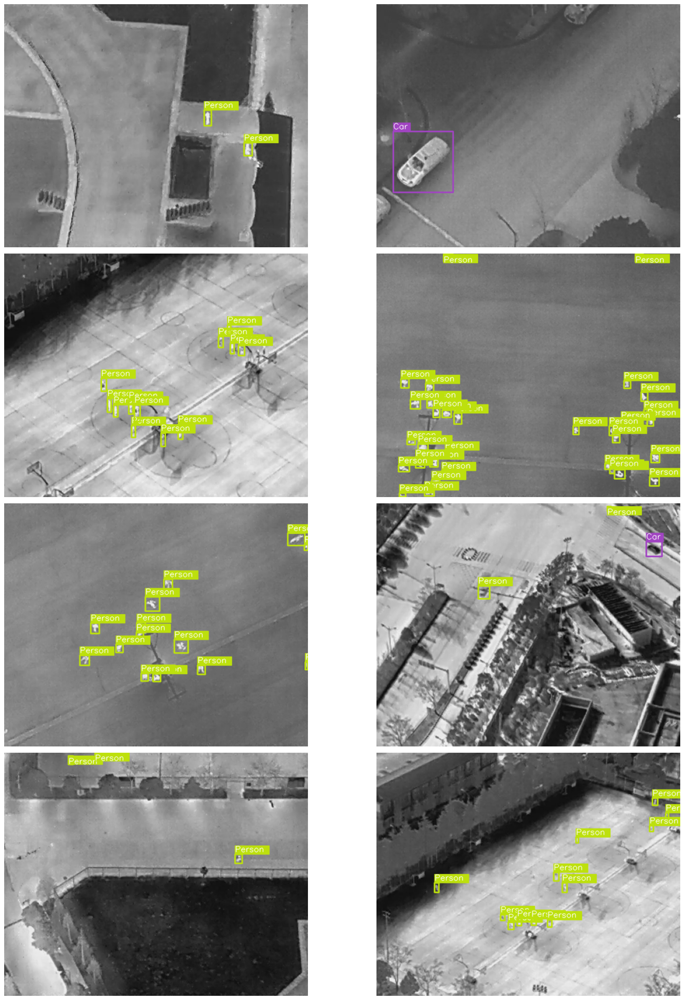

In [35]:
plot(
    image_path=os.path.join(ROOT_DIR, train_imgs_dir), 
    label_path=os.path.join(ROOT_DIR, train_labels_dir),
    num_samples=8
)

# Model Training

In [36]:
%%writefile dataset.yaml

path: '../hit-uav'
train: 'images/train'
val: 'images/val'
test: 'images/test'
names:
  0: Person
  1: Car
  2: Bicycle
  3: OtherVehicle
  4: DontCare
nc: 5

Overwriting dataset.yaml


In [20]:
os.environ['WANDB_DISABLED'] = 'true'

In [21]:
from ultralytics import YOLO
model = YOLO("yolov8m.pt")  # loading a pretrained model

In [26]:
# Use the model
results = model.train(
   data='dataset.yaml',
   imgsz=512,
   epochs=50,
   batch=16,
   name='yolov8m_v8_50e'
)  # train the model

Ultralytics YOLOv8.0.200  Python-3.9.13 torch-2.1.0+cpu CPU (11th Gen Intel Core(TM) i9-11900H 2.50GHz)
engine\trainer: task=detect, mode=train, model=yolov8m.pt, data=dataset.yaml, epochs=50, patience=50, batch=16, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov8m_v8_50e23, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, kera

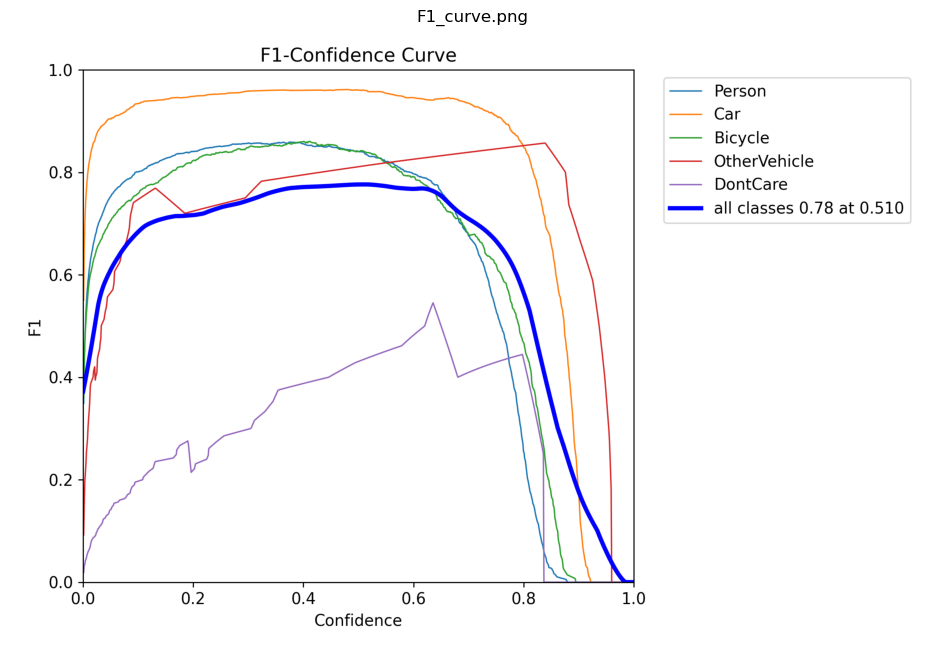

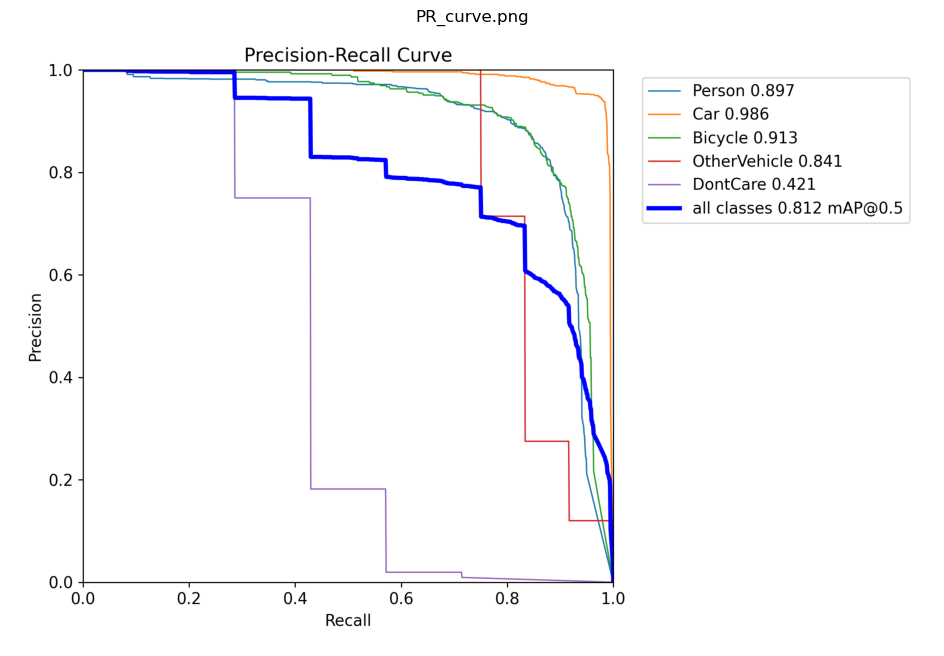

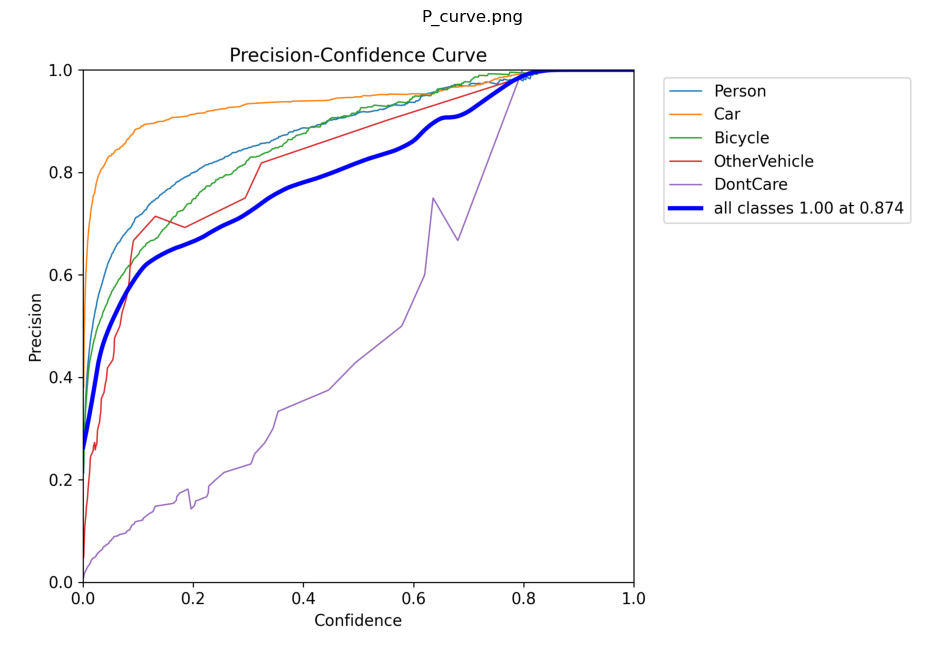

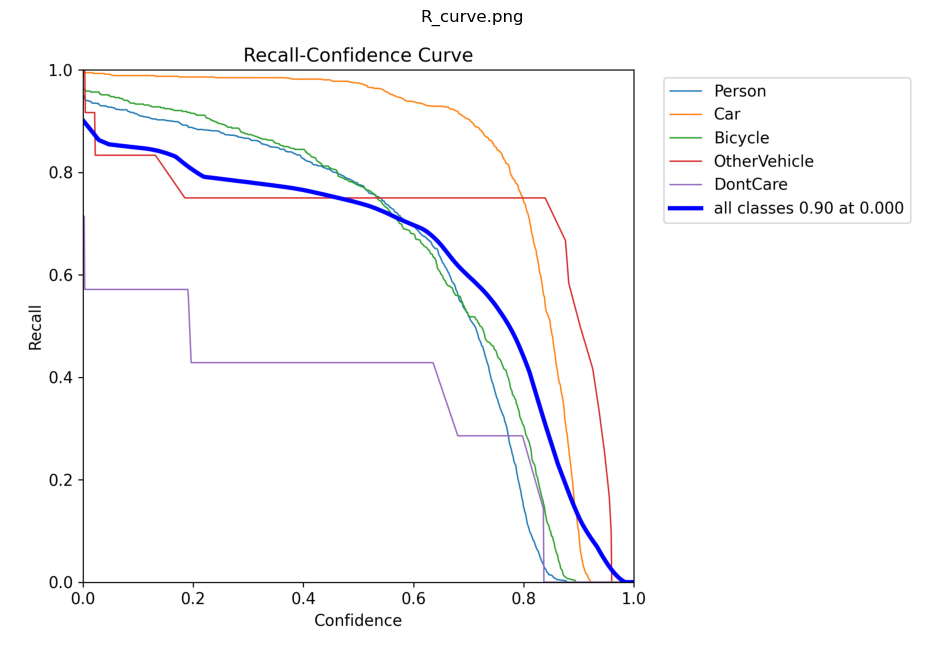

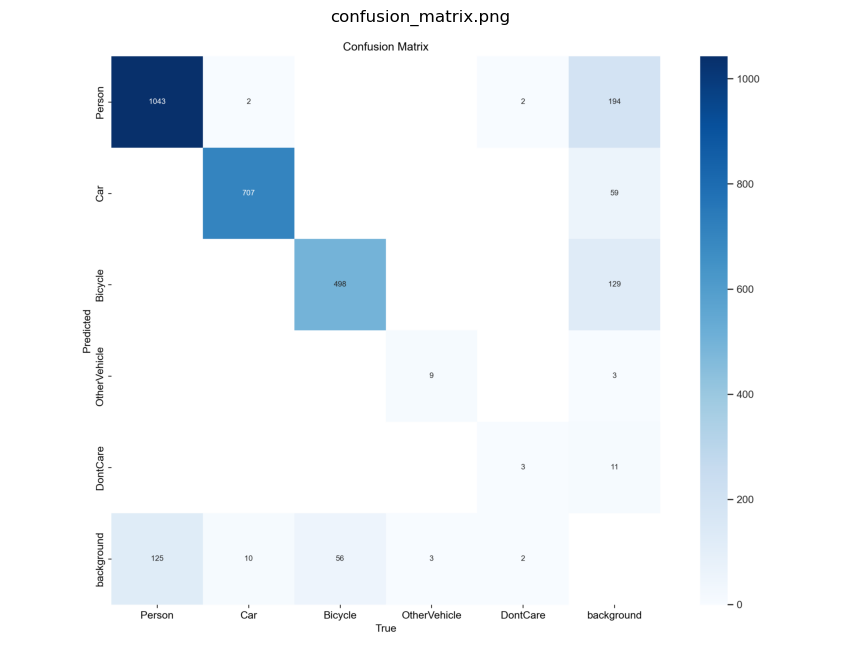

...

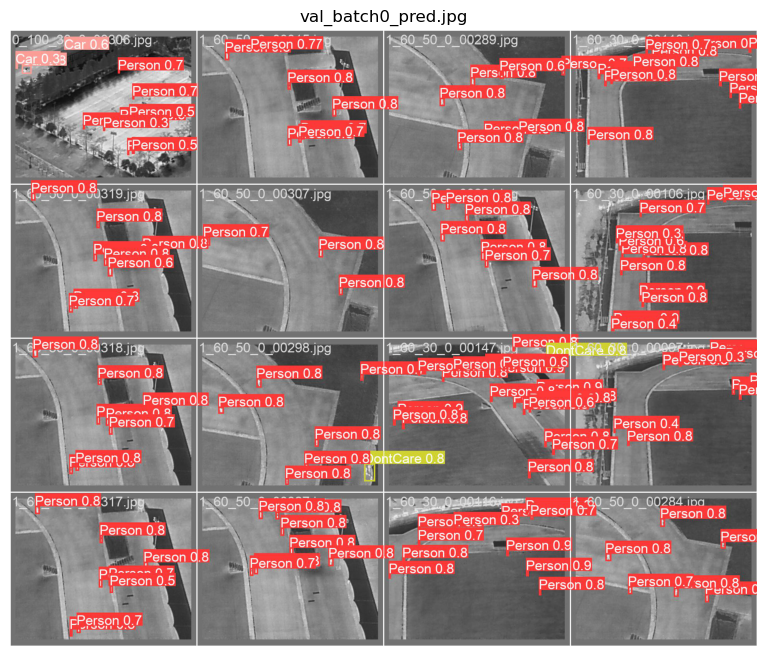

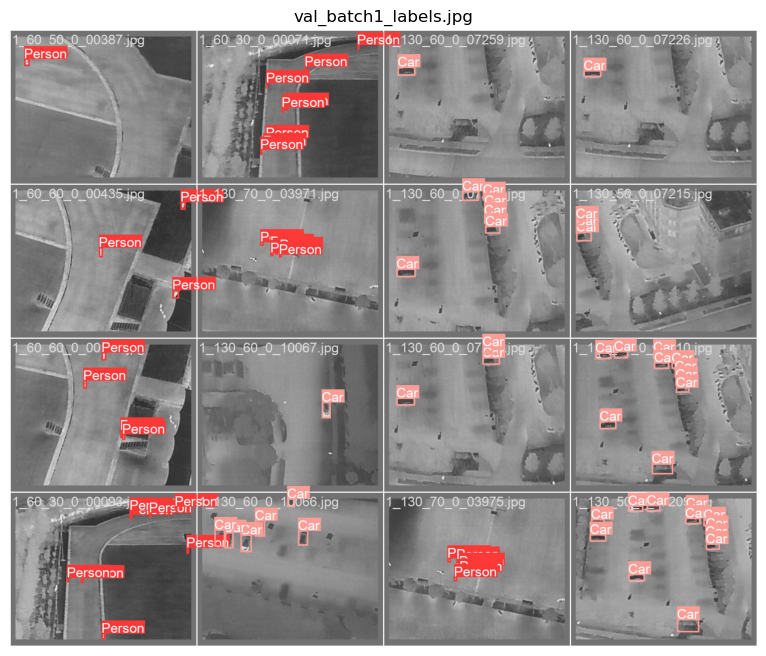

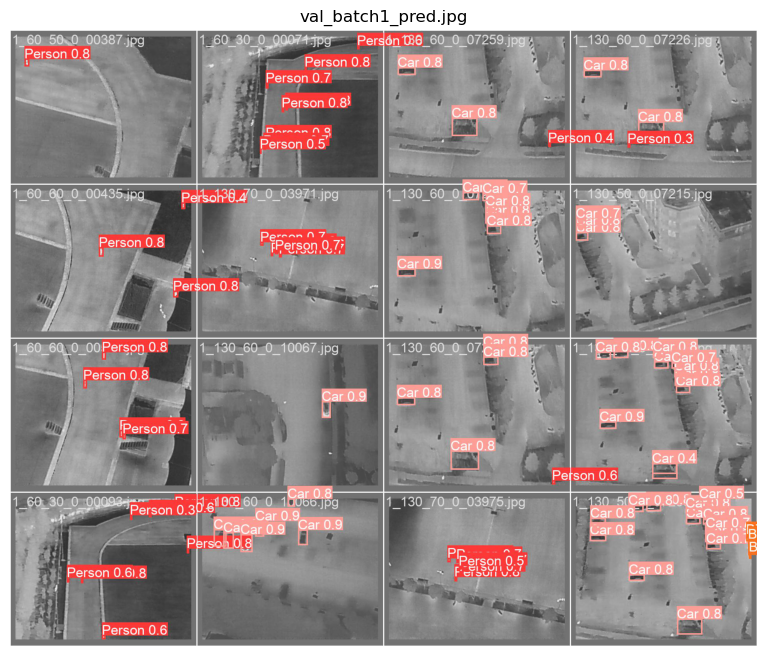

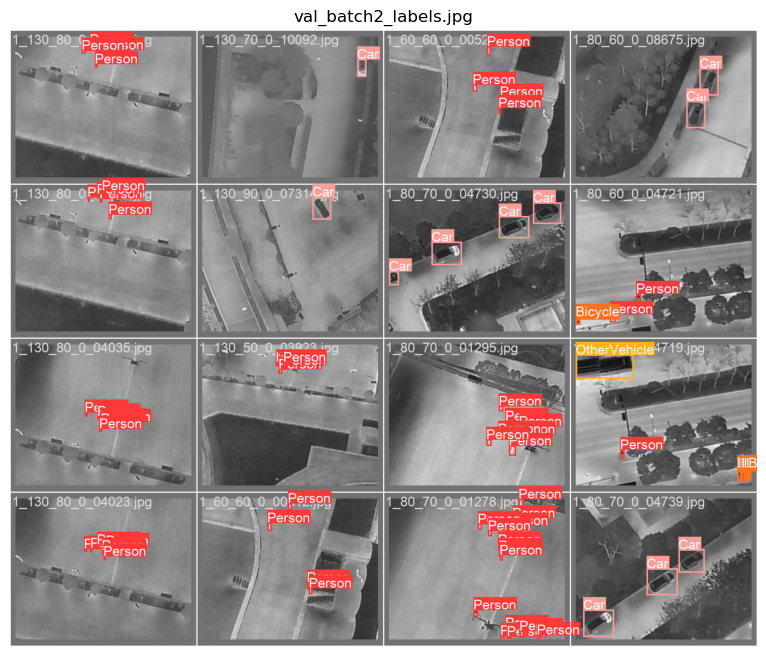

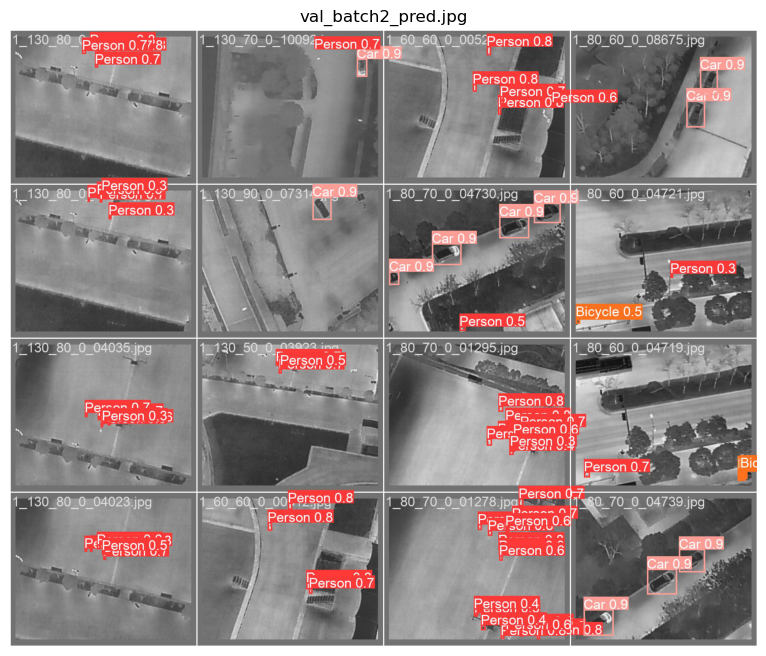

In [78]:
from imutils import paths

log_dir = "runs/detect/yolov8m_v8_50e23"
for image_path in sorted(paths.list_images(log_dir)):
    image = Image.open(image_path)
    plt.figure(figsize=(12, 8))
    plt.imshow(image)
    plt.title(os.path.basename(image_path))
    plt.axis('off')
    plt.show()

In [28]:
results = model(os.path.join(ROOT_DIR, test_imgs_dir), conf=0.5, agnostic_nms=True, iou=0.5, save=True)


image 1/571 C:\Users\tinor\hit-uav\images\test\0_100_30_0_03307.jpg: 416x512 1 Person, 10 Cars, 253.0ms
image 2/571 C:\Users\tinor\hit-uav\images\test\0_100_30_0_08074.jpg: 416x512 9 Cars, 226.0ms
image 3/571 C:\Users\tinor\hit-uav\images\test\0_100_30_0_08091.jpg: 416x512 10 Cars, 229.1ms
image 4/571 C:\Users\tinor\hit-uav\images\test\0_100_30_0_08100.jpg: 416x512 3 Cars, 225.0ms
image 5/571 C:\Users\tinor\hit-uav\images\test\0_100_40_0_03327.jpg: 416x512 2 Persons, 235.0ms
image 6/571 C:\Users\tinor\hit-uav\images\test\0_100_40_0_03332.jpg: 416x512 3 Persons, 228.1ms
image 7/571 C:\Users\tinor\hit-uav\images\test\0_100_40_0_03342.jpg: 416x512 2 Persons, 223.0ms
image 8/571 C:\Users\tinor\hit-uav\images\test\0_100_40_0_03347.jpg: 416x512 4 Persons, 247.5ms
image 9/571 C:\Users\tinor\hit-uav\images\test\0_100_40_0_08132.jpg: 416x512 2 Cars, 1 OtherVehicle, 252.0ms
image 10/571 C:\Users\tinor\hit-uav\images\test\0_100_40_0_08134.jpg: 416x512 2 Cars, 1 OtherVehicle, 232.0ms
image 11/571

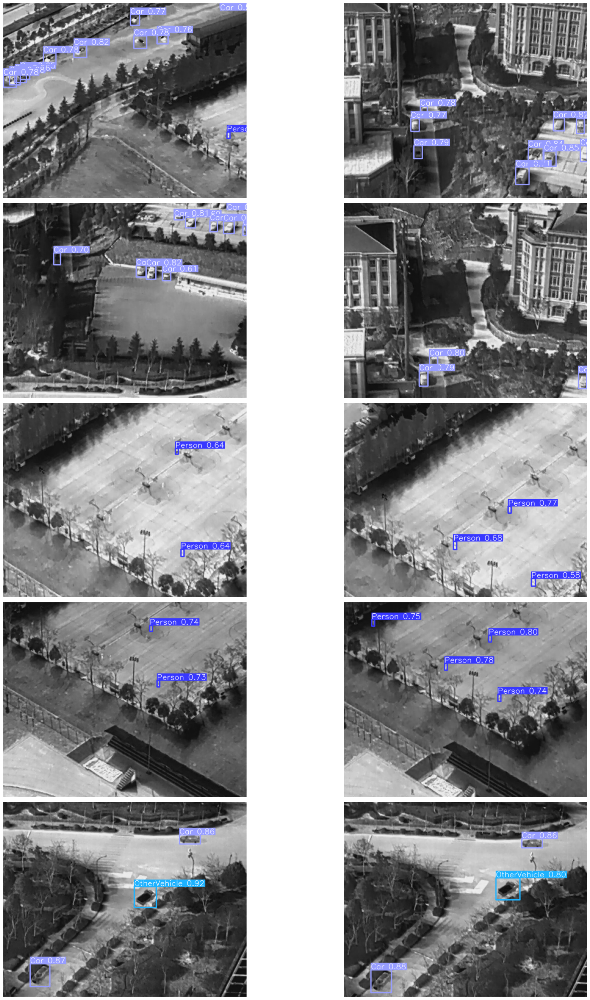

In [55]:
indices = list(range(len(results)))
random_indices = random.sample(indices, 10)
num_cols = 2
num_rows = 5

plt.figure(figsize=(12 * num_cols, 6 * num_rows))
    
for i, idx in enumerate(random_indices):
    image = results[i].plot()
    plt.subplot(num_rows, num_cols, i+1)
    plt.imshow(image)
    plt.axis('off')
plt.tight_layout()
plt.show()

In [37]:
ground_colors = [(255, 0, 0) for _ in range(len(classes))]

In [38]:
ls runs\detect

 Volume in drive D is New Volume
 Volume Serial Number is DC1A-6DBE

 Directory of D:\PRO\runs\detect

24-10-2023  21:07    <DIR>          .
24-10-2023  21:07    <DIR>          ..
24-10-2023  18:52    <DIR>          predict
24-10-2023  21:07    <DIR>          yolov8m_v8_50e23
22-10-2023  06:22    <DIR>          yolov8m_v8_50e232
               0 File(s)              0 bytes
               5 Dir(s)  48,096,342,016 bytes free


# Model Evaluation

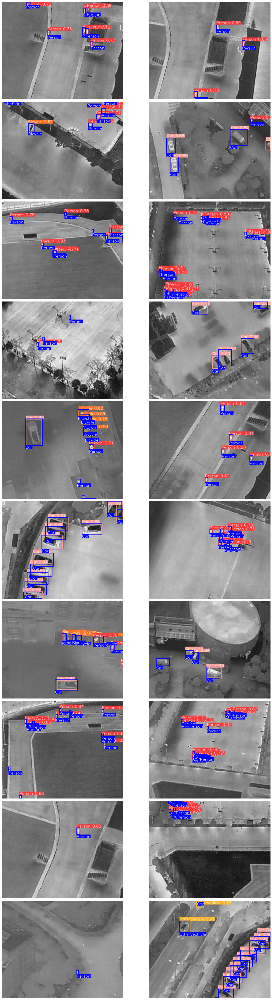

In [50]:
# Comparing a few testing images.
plot(
    image_path='runs/detect/yolov8m_v8_50e232', 
    label_path=os.path.join(ROOT_DIR, test_labels_dir),
    num_samples=20,
    classes=classes,
    colors=ground_colors,
    pos='below'
)

In [41]:
success = model.export(format="onnx")  # export the model to ONNX format
success

Ultralytics YOLOv8.0.200  Python-3.9.13 torch-2.1.0+cpu CPU (11th Gen Intel Core(TM) i9-11900H 2.50GHz)

PyTorch: starting from 'runs\detect\yolov8m_v8_50e23\weights\best.pt' with input shape (1, 3, 512, 512) BCHW and output shape(s) (1, 9, 5376) (49.6 MB)

ONNX: starting export with onnx 1.14.1 opset 17...
ONNX: export success  1.8s, saved as 'runs\detect\yolov8m_v8_50e23\weights\best.onnx' (98.7 MB)

Export complete (3.9s)
Results saved to C:\Users\tinor\runs\detect\yolov8m_v8_50e23\weights
Predict:         yolo predict task=detect model=runs\detect\yolov8m_v8_50e23\weights\best.onnx imgsz=512  
Validate:        yolo val task=detect model=runs\detect\yolov8m_v8_50e23\weights\best.onnx imgsz=512 data=dataset.yaml  
Visualize:       https://netron.app


'runs\\detect\\yolov8m_v8_50e23\\weights\\best.onnx'

# Model Validation

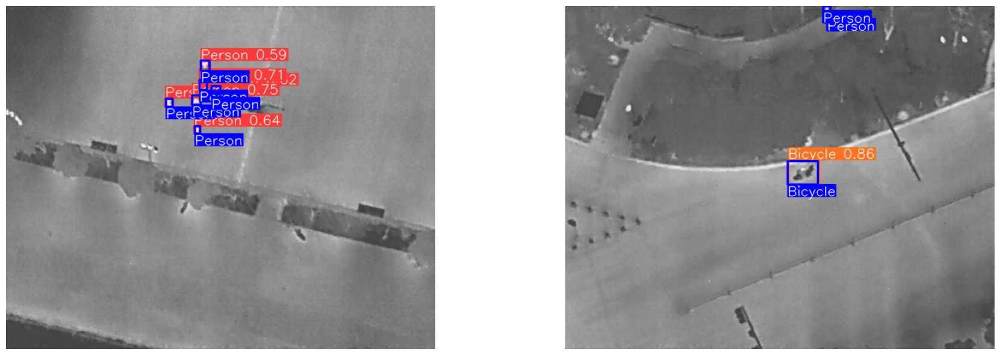

In [14]:
# Comparing a few testing images.
plot(
    image_path='runs/detect/yolov8m_v8_50e232', 
    label_path=os.path.join(ROOT_DIR, test_labels_dir),
    num_samples=2,
    classes=classes,
    colors=ground_colors,
    pos='below'
)

In [48]:
!yolo task=detect mode=predict model=runs\detect\yolov8m_v8_50e23\weights\best.pt source="upload/test2.jpg"

Ultralytics YOLOv8.0.200  Python-3.9.13 torch-2.1.0+cpu CPU (11th Gen Intel Core(TM) i9-11900H 2.50GHz)
Model summary (fused): 218 layers, 25842655 parameters, 0 gradients, 78.7 GFLOPs

image 1/1 D:\PRO\upload\test2.jpg: 416x512 9 Cars, 12 Bicycles, 250.9ms
Speed: 0.0ms preprocess, 250.9ms inference, 15.6ms postprocess per image at shape (1, 3, 416, 512)
Results saved to runs\detect\predict3
 Learn more at https://docs.ultralytics.com/modes/predict


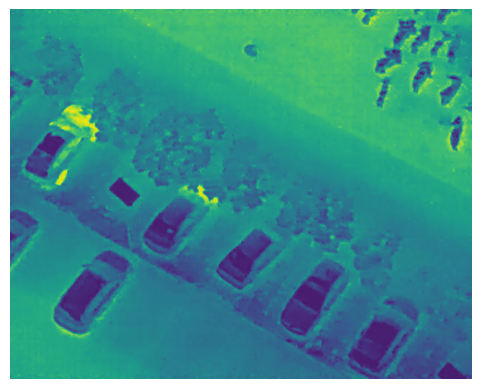

In [47]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
img = mpimg.imread("upload/test2.jpg")

# Display the image
plt.imshow(img)
plt.axis('off')  # Hide the axis (optional)
plt.show()

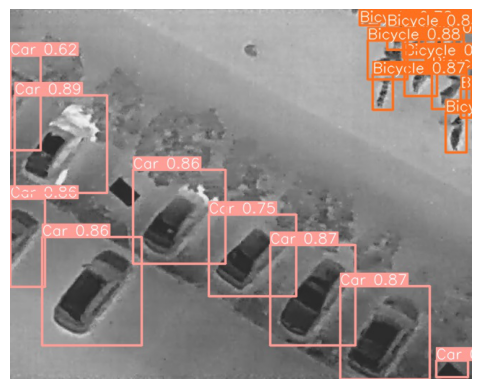

In [49]:
img = mpimg.imread("runs/detect/predict3/test2.jpg")

# Display the image
plt.imshow(img)
plt.axis('off')  # Hide the axis (optional)
plt.show()